# Exploratory Data Analysis on Store Sales Data

####  The goal of this competation is to help an Ecuador company as known as Corporación Favorita to predict store sales for each product family and store combinations. 

#### We have 6 datasets: holiday_events, oil price, stores, earthquake, transactiontest, train and test data. 

#### I want to apply data cleaning methods to detect outliers and missing values and conduct univariate and bivariate analysis to understand explore holiday, earthquake, oil price, seasonal effect on sales/transactions.

#### Let's get started:)

## 4. Multivariate Analysis

### 4.1 Seasonal Effect 

#### Time Series plot for family on sales by date

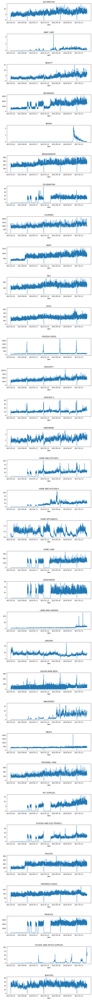

In [15]:
fig= plt.figure(figsize=(10,120))
fig.subplots_adjust(hspace=0.75)
for i, product in enumerate(cluster_info.family.unique()):
    ax = fig.add_subplot(33,1,i+1)
    cluster_info.query('family == @product').groupby(['date']).sales.mean().plot()
    plt.title(product)

#### Time Series plot for family on sales by year

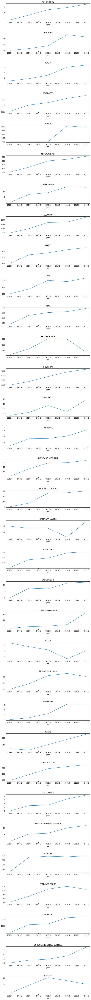

In [16]:
import time
s=time.time()
cluster_data = pd.to_datetime(cluster_info['date'], format="%Y-%m-%d")
cluster_info.insert(0,'day',cluster_data.dt.day)
cluster_info.insert(0,'month',cluster_data.dt.month)
cluster_info.insert(0,'year',cluster_data.dt.year)

fig= plt.figure(figsize=(10,120))
fig.subplots_adjust(hspace=0.75)
for i, product in enumerate(cluster_info.family.unique()):
    ax = fig.add_subplot(33,1,i+1)
    cluster_info.query('family == @product').groupby(['year']).sales.mean().plot()
    plt.title(product)

#### Time Series plot for family on sales by month

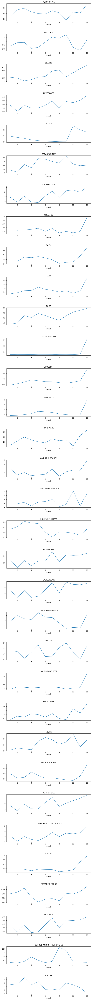

In [17]:
fig= plt.figure(figsize=(10,120))
fig.subplots_adjust(hspace=0.75)
for i, product in enumerate(cluster_info.family.unique()):
    ax = fig.add_subplot(33,1,i+1)
    cluster_info.query('family == @product').groupby(['month']).sales.mean().plot()
    plt.title(product)

#### We can tell from these charts that sales of most products will increase at end of every year

In [18]:
a = transactions_table.copy()
#convert datetime
a['date'] = pd.to_datetime(a['date'])
a["year"] = a.date.dt.year
a["month"] = a.date.dt.month

a = a.set_index("date").resample("M").transactions.mean().reset_index()
a["year"] = a.date.dt.year
px.line(a, x='date', y='transactions', color='year',title = "Monthly Average Transactions" )

In [19]:
#Daliy sales of every store
a = cluster_info.copy()
a['date'] = pd.to_datetime(a['date'])
a = a.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()
px.line(a, x = "date", y= "sales", color = "store_nbr", title = "Daily total sales of the stores")

#### We can tell from above chart that transaction increase at end of every year.

#### Are The Product Families Active or Passive?
We know that some products might be less popular and has relatively less sales volume. It may be caused by seasonality or other events but doesn't mean that their volume will kept in this level.

We will do some deep search and figure out which products are "true active" and which products are "false active". We picked 60 days as time window for our experiement.

In [20]:
b = cluster_info.groupby(["family", "store_nbr"]).tail(60).groupby(["family", "store_nbr"]).sales.sum().reset_index()
b[b.sales == 0]

,family,store_nbr,sales
54,BABY CARE,1,0.0
55,BABY CARE,2,0.0
63,BABY CARE,10,0.0
65,BABY CARE,12,0.0
66,BABY CARE,13,0.0
67,BABY CARE,14,0.0
76,BABY CARE,23,0.0
79,BABY CARE,26,0.0
85,BABY CARE,32,0.0
86,BABY CARE,33,0.0


#### To see sales effected by seasonal and time factors, we selected a store which has a 0 sales record in 60 days for every product family:

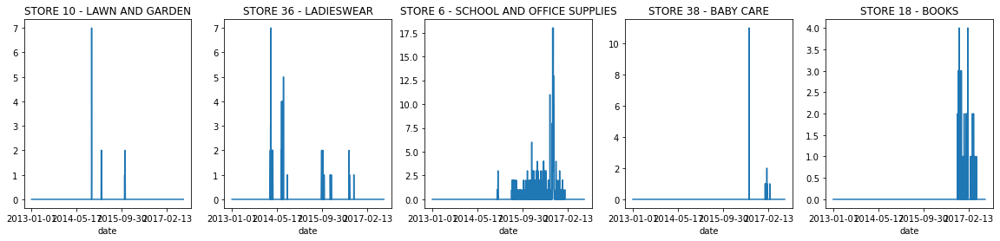

In [21]:
fig, ax = plt.subplots(1,5, figsize = (20,4))
cluster_info[(cluster_info.store_nbr == 10) & (cluster_info.family == "LAWN AND GARDEN")].set_index("date").sales.plot(ax = ax[0], title = "STORE 10 - LAWN AND GARDEN")
cluster_info[(cluster_info.store_nbr == 36) & (cluster_info.family == "LADIESWEAR")].set_index("date").sales.plot(ax = ax[1], title = "STORE 36 - LADIESWEAR")
cluster_info[(cluster_info.store_nbr == 6) & (cluster_info.family == "SCHOOL AND OFFICE SUPPLIES")].set_index("date").sales.plot(ax = ax[2], title = "STORE 6 - SCHOOL AND OFFICE SUPPLIES")
cluster_info[(cluster_info.store_nbr == 38) & (cluster_info.family == "BABY CARE")].set_index("date").sales.plot(ax = ax[3], title = "STORE 38 - BABY CARE")
cluster_info[(cluster_info.store_nbr == 53) & (cluster_info.family == "BOOKS")].set_index("date").sales.plot(ax = ax[4], title = "STORE 18 - BOOKS")
plt.show()

#### Based on these charts, we can give a more clear view on trends of these stores.

### 4.2 Wage effect

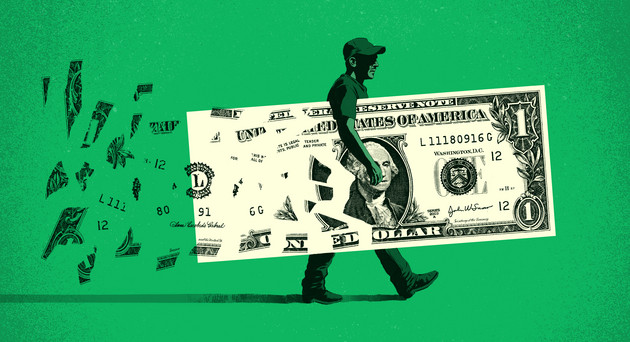

<AxesSubplot:xlabel='date', ylabel='sales'>

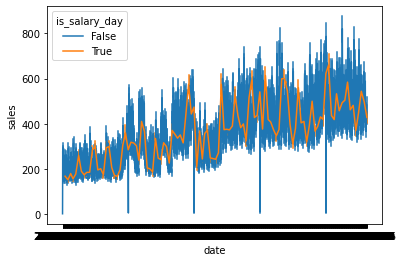

In [22]:
# Filter date of wage which is paid in the middle of month and end of month.
#cluster_info.query('day==15 | day==30')
import calendar
import datetime
from datetime import timedelta
#Last day of a month
#this_mond = datetime.datetime(now.year, now.month, calendar.monthrange(now.year, now.month)[1])
#month_end = cluster_info.datetime(now.year, now.month, calendar.monthrange(now.year, now.month)[1])
#last_day = last_day_of_month(datetime.date(year, month, day))
def mid_last_day_of_month(any_day):
    """
    获取获得一个月中的最后一天
    :param any_day: 任意日期
    :return: string
    """
    if any_day.day == 15:
        return True
    next_month = any_day.replace(day=28) + datetime.timedelta(days=4)  # this will never fail
    last_day_of_month = next_month - datetime.timedelta(days=next_month.day)
    if any_day == last_day_of_month:
        return True
    return False

is_salary_day = [0 for i in range(len(cluster_info))]
date = cluster_info[['year', 'month', 'day']]  # df
for i in range(len(date)):
    is_salary_day[i] = mid_last_day_of_month(datetime.date(date['year'][i], date['month'][i], date['day'][i]))
    
cluster_info['is_salary_day'] = is_salary_day

sns.lineplot(
    data=cluster_info, x="date", y="sales", hue="is_salary_day", err_style="bars", ci=68
)

### 4.3 Earthquake Effect

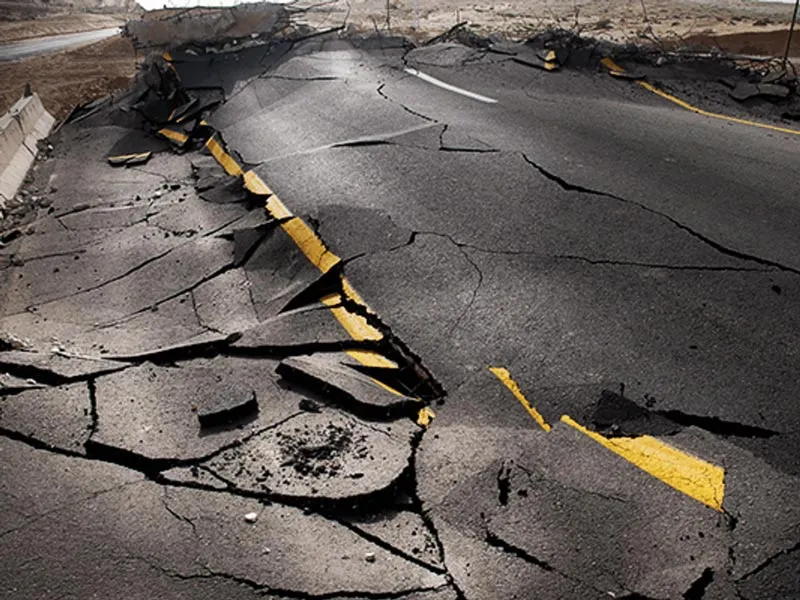

#### A magnitude 7.8 earthquake struck Ecuador on April 16, 2016 and it will effect sales of following weeks after earthquake. So we set 8 weeks as time window to see effect of earthquake on sales in this period.

In [23]:
#See sales difference between year
from numpy import mean
plt.figure(figsize=(16,12))
cluster_info['date'] = pd.to_datetime(cluster_info['date'])
earth_data2013 = cluster_info[(cluster_info['date'] >=pd.to_datetime('2013-01-01')) & (cluster_info['date'] <= pd.to_datetime('2014-01-01'))]
earth_data2013 = earth_data2013[['date', 'month', 'sales']].groupby(['month']).mean().reset_index()
fig=px.line(earth_data2013,x='month',y='sales',title='Sales Trend 2013')
fig.show()

<Figure size 1152x864 with 0 Axes>

In [24]:
#See sales difference between year
from numpy import mean
plt.figure(figsize=(16,12))
cluster_info['date'] = pd.to_datetime(cluster_info['date'])
earth_data2014 = cluster_info[(cluster_info['date'] >=pd.to_datetime('2014-01-01')) & (cluster_info['date'] <= pd.to_datetime('2015-01-01'))]
earth_data2014 = earth_data2014[['date', 'month', 'sales']].groupby(['month']).mean().reset_index()
fig=px.line(earth_data2014,x='month',y='sales',title='Sales Trend 2014')
fig.show()

<Figure size 1152x864 with 0 Axes>

In [25]:
#See sales difference between year
from numpy import mean
plt.figure(figsize=(16,12))
cluster_info['date'] = pd.to_datetime(cluster_info['date'])
earth_data2015 = cluster_info[(cluster_info['date'] >=pd.to_datetime('2015-01-01')) & (cluster_info['date'] <= pd.to_datetime('2016-01-01'))]
earth_data2015 = earth_data2015[['date', 'month', 'sales']].groupby(['month']).mean().reset_index()
fig=px.line(earth_data2015,x='month',y='sales',title='Sales Trend 2015')
fig.show()

<Figure size 1152x864 with 0 Axes>

In [26]:
#See sales difference between year
from numpy import mean
plt.figure(figsize=(16,12))
cluster_info['date'] = pd.to_datetime(cluster_info['date'])
earth_data2016 = cluster_info[(cluster_info['date'] >=pd.to_datetime('2016-01-01')) & (cluster_info['date'] <= pd.to_datetime('2017-01-01'))]
earth_data2016 = earth_data2016[['date', 'month', 'sales']].groupby(['month']).mean().reset_index()
fig=px.line(earth_data2016,x='month',y='sales',title='Sales Trend 2016')
fig.show()

<Figure size 1152x864 with 0 Axes>

In [27]:
cluster_info['date'] = pd.to_datetime(cluster_info['date'])
earth_data = cluster_info[(cluster_info['date'] >=pd.to_datetime('2016-04-16')) & (cluster_info['date'] <= pd.to_datetime('2016-06-16'))]
from numpy import mean
plt.figure(figsize=(16,12))
cluster_info['date'] = pd.to_datetime(cluster_info['date'])
earthquake_data2016 = cluster_info[(cluster_info['date'] >=pd.to_datetime('2016-04-16')) & (cluster_info['date'] <= pd.to_datetime('2016-06-16'))]
earthquake_data2016.head()
fig=px.line(earthquake_data2016,x='date',y='sales',title='April to July in 2016')
fig.show()

<Figure size 1152x864 with 0 Axes>

#### We can see a sudden drop after the earthquake and sales was in a relatively low level. It can be concluded that earthquake did have a significant impact on sales in Ecuador.

In [28]:
#See sales difference between year
from numpy import mean
plt.figure(figsize=(16,12))
cluster_info['date'] = pd.to_datetime(cluster_info['date'])
earth_data2017 = cluster_info[(cluster_info['date'] >=pd.to_datetime('2017-01-01')) & (cluster_info['date'] <= pd.to_datetime('2018-01-01'))]
earth_data2017 = earth_data2017[['date', 'month', 'sales']].groupby(['month']).mean().reset_index()
fig=px.line(earth_data2017,x='month',y='sales',title='Sales Trend 2017')
fig.show()

<Figure size 1152x864 with 0 Axes>

#### Based on this chart, we can see sales back to normal, and even higher at the end of 2017.

### 4.4 Holiday Effect

<AxesSubplot:xlabel='date', ylabel='sales'>

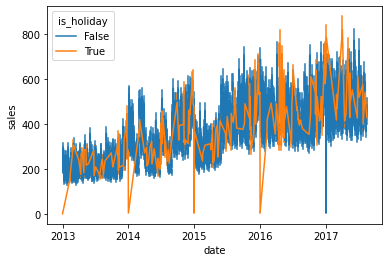

In [37]:
holiday_table_clear['date']=pd.to_datetime(holiday_table_clear['date'],format='%Y/%m/%d')
#merge holiday_table_clear and cluster_info
holiday_effect = pd.merge(left=cluster_info[['store_nbr','date','sales']], right=holiday_table_clear[['date','type','locale','locale_name','transferred']], how='left', on='date')
# Missing value
holiday_effect.isnull().sum()
#Fill in missing value
holiday_effect = holiday_effect.fillna(value=0)

#Add new column"is_holiday"
holiday_effect['is_holiday'] = holiday_effect['type'].apply(lambda x: True if x != 0 else False)

sns.lineplot(
    data=holiday_effect, x="date", y="sales", hue="is_holiday", err_style="bars", ci=68
)

#### We can conclude from the chart that sales are relatively high in holidays. We decide to apply A/B testing on events to see effect of events on sales.

In [41]:
holiday_table = pd.read_csv('holidays_events.csv')
holiday_table["date"] = pd.to_datetime(holiday_table.date)

#Trnsferred holidays
tr1 = holiday_table[(holiday_table.type == "Holiday") & (holiday_table.transferred == True)].drop("transferred", axis = 1).reset_index(drop = True)
tr2 = holiday_table[(holiday_table.type == "Transfer")].drop("transferred", axis = 1).reset_index(drop = True)
tr = pd.concat([tr1,tr2], axis = 1)
tr = tr.iloc[:, [5,1,2,3,4]]

holidays = holiday_table[(holiday_table.transferred == False) & (holiday_table.type != "Transfer")].drop("transferred", axis = 1)
holidays = holiday_table.append(tr).reset_index(drop = True)

# Additional Holidays: turn addtional days into holidays
#'\d+' 表示1个或多个0到9的数字,是整数部分
holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')
holidays["type"] = np.where(holidays["type"] == "Additional", "Holiday", holidays["type"])

# Bridge Holidays
holidays["description"] = holidays["description"].str.replace("Puente ", "")
holidays["type"] = np.where(holidays["type"] == "Bridge", "Holiday", holidays["type"])

# Work Day Holidays, that is meant to payback the Bridge.
work_day = holidays[holidays.type == "Work Day"]  
holidays = holidays[holidays.type != "Work Day"]

# Split

# Events are national
events = holidays[holidays.type == "Event"].drop(["type", "locale", "locale_name"], axis = 1).rename({"description":"events"}, axis = 1)

holidays = holidays[holidays.type != "Event"].drop("type", axis = 1)
regional = holidays[holidays.locale == "Regional"].rename({"locale_name":"state", "description":"holiday_regional"}, axis = 1).drop("locale", axis = 1).drop_duplicates()
national = holidays[holidays.locale == "National"].rename({"description":"holiday_national"}, axis = 1).drop(["locale", "locale_name"], axis = 1).drop_duplicates()
local = holidays[holidays.locale == "Local"].rename({"description":"holiday_local", "locale_name":"city"}, axis = 1).drop("locale", axis = 1).drop_duplicates()

train_table = pd.read_csv('train.csv')
test_table = pd.read_csv('test.csv')

# Datetime
train_table["date"] = pd.to_datetime(train_table.date)
test_table["date"] = pd.to_datetime(test_table.date)

# Data types
train_table.onpromotion = train_table.onpromotion.astype("float16")
train_table.sales = train_table.sales.astype("float32")

c = pd.merge(train_table.append(test_table), stores_table)
c["store_nbr"] = c["store_nbr"].astype("int8")

# National Holidays & Events
c = pd.merge(c, national, how = "left")
# Regional
c = pd.merge(c, regional, how = "left", on = ["date", "state"])
# Local
c = pd.merge(c, local, how = "left", on = ["date", "city"])

# Work Day: It will be removed when real work day colum created
c = pd.merge(c,  work_day[["date", "type"]].rename({"type":"IsWorkDay"}, axis = 1),how = "left")

# EVENTS
events["events"] =np.where(events.events.str.contains("futbol"), "Futbol", events.events)

def one_hot_encoder(df, nan_as_category=True):
    original_columns = list(df.columns)
    categorical_columns = df.select_dtypes(["category", "object"]).columns.tolist()
    # categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns=categorical_columns, dummy_na=nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    df.columns = df.columns.str.replace(" ", "_")
    return df, df.columns.tolist()

events, events_cat = one_hot_encoder(events, nan_as_category=False)
events["events_Dia_de_la_Madre"] = np.where(events.date == "2016-05-08", 1, events["events_Dia_de_la_Madre"])

c = pd.merge(c, events, how = "left")
c[events_cat] = c[events_cat].fillna(0)

# New features
c["holiday_national_binary"] = np.where(c.holiday_national.notnull(), 1, 0)
c["holiday_local_binary"] = np.where(c.holiday_local.notnull(), 1, 0)
c["holiday_regional_binary"] = np.where(c.holiday_regional.notnull(), 1, 0)

# 
c["national_independence"] = np.where(c.holiday_national.isin(['Batalla de Pichincha', 'Independencia de Cuenca', 'Independencia de Guayaquil', 'Independencia de Guayaquil', 'Primer Grito de Independencia']), 1, 0)
c["local_cantonizacio"] = np.where(c.holiday_local.str.contains("Cantonizacio"), 1, 0)
c["local_fundacion"] = np.where(c.holiday_local.str.contains("Fundacion"), 1, 0)
c["local_independencia"] = np.where(c.holiday_local.str.contains("Independencia"), 1, 0)


holidays, holidays_cat = one_hot_encoder(c[["holiday_national","holiday_regional","holiday_local"]], nan_as_category=False)
c = pd.concat([c.drop(["holiday_national","holiday_regional","holiday_local"], axis = 1),holidays], axis = 1)

he_cols = c.columns[c.columns.str.startswith("events")].tolist() + c.columns[c.columns.str.startswith("holiday")].tolist() + c.columns[c.columns.str.startswith("national")].tolist()+ c.columns[c.columns.str.startswith("local")].tolist()
c[he_cols] = c[he_cols].astype("int8")

c[["family", "city", "state", "type"]] = c[["family", "city", "state", "type"]].astype("category")

del holidays, holidays_cat, work_day, local, regional, national, events, events_cat, tr, tr1, tr2, he_cols


c.head(10)

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,...,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,holiday_local_Traslado_Fundacion_de_Guayaquil
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
1,1,2013-01-01,1,BABY CARE,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
2,2,2013-01-01,1,BEAUTY,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
4,4,2013-01-01,1,BOOKS,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
5,5,2013-01-01,1,BREAD/BAKERY,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
6,6,2013-01-01,1,CELEBRATION,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
7,7,2013-01-01,1,CLEANING,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
8,8,2013-01-01,1,DAIRY,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0
9,9,2013-01-01,1,DELI,0.0,0.0,Quito,Pichincha,D,13,...,0,0,0,0,0,0,0,0,0,0


In [42]:
def AB_Test(dataframe, group, target):
    
    # Packages
    from scipy.stats import shapiro
    import scipy.stats as stats
    
    # Split A/B
    groupA = dataframe[dataframe[group] == 1][target]
    groupB = dataframe[dataframe[group] == 0][target]
    
    # Assumption: Normality
    ntA = shapiro(groupA)[1] < 0.05
    ntB = shapiro(groupB)[1] < 0.05
    # H0: Distribution is Normal! - False
    # H1: Distribution is not Normal! - True
    
    if (ntA == False) & (ntB == False): # "H0: Normal Distribution"
        # Parametric Test
        # Assumption: Homogeneity of variances
        leveneTest = stats.levene(groupA, groupB)[1] < 0.05
        # H0: Homogeneity: False
        # H1: Heterogeneous: True
        
        if leveneTest == False:
            # Homogeneity
            ttest = stats.ttest_ind(groupA, groupB, equal_var=True)[1]
            # H0: M1 == M2 - False
            # H1: M1 != M2 - True
        else:
            # Heterogeneous
            ttest = stats.ttest_ind(groupA, groupB, equal_var=False)[1]
            # H0: M1 == M2 - False
            # H1: M1 != M2 - True
    else:
        # Non-Parametric Test
        ttest = stats.mannwhitneyu(groupA, groupB)[1] 
        # H0: M1 == M2 - False
        # H1: M1 != M2 - True
        
    # Result
    temp = pd.DataFrame({
        "AB Hypothesis":[ttest < 0.05], 
        "p-value":[ttest]
    })
    temp["Test Type"] = np.where((ntA == False) & (ntB == False), "Parametric", "Non-Parametric")
    temp["AB Hypothesis"] = np.where(temp["AB Hypothesis"] == False, "Fail to Reject H0", "Reject H0")
    temp["Comment"] = np.where(temp["AB Hypothesis"] == "Fail to Reject H0", "A/B groups are similar!", "A/B groups are not similar!")
    temp["Feature"] = group
    temp["GroupA_mean"] = groupA.mean()
    temp["GroupB_mean"] = groupB.mean()
    temp["GroupA_median"] = groupA.median()
    temp["GroupB_median"] = groupB.median()
    
    # Columns
    if (ntA == False) & (ntB == False):
        temp["Homogeneity"] = np.where(leveneTest == False, "Yes", "No")
        temp = temp[["Feature","Test Type", "Homogeneity","AB Hypothesis", "p-value", "Comment", "GroupA_mean", "GroupB_mean", "GroupA_median", "GroupB_median"]]
    else:
        temp = temp[["Feature","Test Type","AB Hypothesis", "p-value", "Comment", "GroupA_mean", "GroupB_mean", "GroupA_median", "GroupB_median"]]
    
    # Print Hypothesis
    # print("# A/B Testing Hypothesis")
    # print("H0: A == B")
    # print("H1: A != B", "\n")
    
    return temp
    
# Apply A/B Testing
he_cols = c.columns[c.columns.str.startswith("events")].tolist() + c.columns[c.columns.str.startswith("holiday")].tolist() + c.columns[c.columns.str.startswith("national")].tolist()+ c.columns[c.columns.str.startswith("local")].tolist()
ab = []
for i in he_cols:
    ab.append(AB_Test(dataframe=c[c.sales.notnull()], group = i, target = "sales"))
ab = pd.concat(ab)
ab

,Feature,Test Type,AB Hypothesis,p-value,Comment,GroupA_mean,GroupB_mean,GroupA_median,GroupB_median
0,events_Black_Friday,Non-Parametric,Reject H0,2.612662e-20,A/B groups are not similar!,363.360901,357.281464,17.000000,11.0
0,events_Cyber_Monday,Non-Parametric,Reject H0,3.850570e-27,A/B groups are not similar!,436.219879,357.153992,17.000000,11.0
0,events_Dia_de_la_Madre,Non-Parametric,Fail to Reject H0,3.499424e-01,A/B groups are similar!,367.216644,357.264465,12.000000,11.0
0,events_Futbol,Non-Parametric,Reject H0,1.236294e-95,A/B groups are not similar!,310.964752,357.693176,5.000000,11.0
0,events_Terremoto_Manabi,Non-Parametric,Reject H0,0.000000e+00,A/B groups are not similar!,494.903076,354.779999,23.000000,11.0
0,holiday_national_binary,Non-Parametric,Reject H0,1.045859e-06,A/B groups are not similar!,417.331177,353.957886,12.000000,11.0
0,holiday_local_binary,Non-Parametric,Reject H0,9.377888e-15,A/B groups are not similar!,419.943909,357.033356,14.000000,11.0
0,holiday_regional_binary,Non-Parametric,Reject H0,1.591879e-04,A/B groups are not similar!,229.725403,357.332458,6.000000,11.0
0,holiday_national_Batalla_de_Pichincha,Non-Parametric,Reject H0,1.451750e-11,A/B groups are not similar!,388.245056,357.173370,14.000000,11.0
0,holiday_national_Carnaval,Non-Parametric,Reject H0,5.037974e-03,A/B groups are not similar!,332.882568,357.449799,10.000000,11.0
